# A EDA notebook because Mathias needs it!!!!

In [462]:
#imports
import pandas as pd
import matplotlib.pyplot as plt

## Retrieveing all datasets 

In [463]:
# A
train_targets_a = pd.read_parquet('../data/A/train_targets.parquet')
X_test_estimated_a = pd.read_parquet('../data/A/X_test_estimated.parquet')
X_train_estimated_a = pd.read_parquet('../data/A/X_train_estimated.parquet')
X_train_observed_a = pd.read_parquet('../data/A/X_train_observed.parquet')

# B
train_targets_b = pd.read_parquet('../data/B/train_targets.parquet')
X_test_estimated_b = pd.read_parquet('../data/B/X_test_estimated.parquet')
X_train_estimated_b = pd.read_parquet('../data/B/X_train_estimated.parquet')
X_train_observed_b = pd.read_parquet('../data/B/X_train_observed.parquet')

# C
train_targets_c = pd.read_parquet('../data/C/train_targets.parquet')
X_test_estimated_c = pd.read_parquet('../data/C/X_test_estimated.parquet')
X_train_estimated_c = pd.read_parquet('../data/C/X_train_estimated.parquet')
X_train_observed_c = pd.read_parquet('../data/C/X_train_observed.parquet')


## Looking at all sets for A, just to see what each set looks like

##### train_targets_a

In [464]:
train_targets_a.head()

,time,pv_measurement
0,2019-06-02 22:00:00,0.00
1,2019-06-02 23:00:00,0.00
2,2019-06-03 00:00:00,0.00
3,2019-06-03 01:00:00,0.00
4,2019-06-03 02:00:00,19.36


Note: We can see just from this head that there are some pv_measurements of 0, these should probably be discarded or maybe not? Will investigate further down

##### X_test_estimated_a

In [465]:
X_test_estimated_a.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2023-04-30 07:00:04,2023-05-01 00:00:00,4.4,1.286,912.700012,0.0,0.0,1041.199951,0.0,271.700012,...,10.520000,-11.185,0.0,273.799988,80.699997,30210.699219,4.0,2.2,3.4,-0.0
1,2023-04-30 07:00:04,2023-05-01 00:15:00,4.3,1.287,912.700012,0.0,0.0,1054.800049,0.0,271.700012,...,14.203000,-10.825,0.0,273.799988,77.000000,30003.599609,4.0,2.1,3.4,-0.0
2,2023-04-30 07:00:04,2023-05-01 00:30:00,4.3,1.287,912.700012,0.0,0.0,1068.300049,0.0,271.600006,...,17.868999,-10.360,0.0,273.799988,73.099998,29797.099609,3.9,2.1,3.3,-0.0
3,2023-04-30 07:00:04,2023-05-01 00:45:00,4.3,1.287,912.700012,0.0,0.0,1081.900024,0.0,271.600006,...,21.514000,-9.794,0.0,273.799988,69.000000,29618.599609,3.9,2.0,3.3,-0.0
4,2023-04-30 07:00:04,2023-05-01 01:00:00,4.3,1.287,NaN,0.0,0.0,1095.400024,0.0,271.600006,...,25.135000,-9.128,0.0,273.799988,64.500000,29507.500000,3.9,2.0,3.3,-0.0


##### X_train_estimated_a

In [466]:
X_train_estimated_a.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2022-10-27 07:00:18,2022-10-28 22:00:00,8.4,1.233,1425.099976,0.0,0.0,1211.699951,1.0,281.399994,...,340.799011,-38.466999,0.0,284.700012,100.0,29429.699219,0.8,-0.4,0.7,-0.0
1,2022-10-27 07:00:18,2022-10-28 22:15:00,8.4,1.233,2085.899902,0.0,0.0,1560.500000,1.0,281.299988,...,345.451996,-38.955002,0.0,284.700012,100.0,23604.099609,0.7,-0.4,0.7,-0.0
2,2022-10-27 07:00:18,2022-10-28 22:30:00,8.3,1.233,2746.600098,0.0,0.0,1909.400024,1.0,281.200012,...,350.153015,-39.310001,0.0,284.700012,100.0,17799.800781,0.7,-0.3,0.6,-0.0
3,2022-10-27 07:00:18,2022-10-28 22:45:00,8.3,1.233,3407.399902,0.0,0.0,2258.199951,1.0,281.200012,...,354.886993,-39.528999,0.0,284.600006,100.0,12016.500000,0.6,-0.2,0.6,-0.0
4,2022-10-27 07:00:18,2022-10-28 23:00:00,8.2,1.233,4068.199951,0.0,0.0,2607.000000,1.0,281.100006,...,359.638000,-39.609001,0.0,284.600006,100.0,6254.399902,0.6,-0.1,0.6,-0.0


##### X_train_observed_a

In [467]:
X_train_observed_a.head()

,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,diffuse_rad:W,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2019-06-02 22:00:00,7.7,1.230,1744.900024,0.0,0.0,1744.900024,0.0,280.299988,0.0,...,342.834015,-3.202,0.0,285.899994,100.0,39640.101562,3.7,-3.6,-0.8,-0.0
1,2019-06-02 22:15:00,7.7,1.229,1734.000000,0.0,0.0,1734.000000,0.0,280.299988,0.0,...,346.294006,-3.650,0.0,286.100006,100.0,40123.898438,3.6,-3.6,-0.6,-0.0
2,2019-06-02 22:30:00,7.7,1.228,1723.500000,0.0,0.0,1723.500000,0.0,280.299988,0.0,...,349.768005,-3.998,0.0,286.299988,100.0,40628.300781,3.6,-3.6,-0.4,-0.0
3,2019-06-02 22:45:00,7.7,1.226,1713.400024,0.0,0.0,1713.400024,0.0,280.299988,0.0,...,353.251007,-4.247,0.0,286.600006,100.0,41153.601562,3.5,-3.5,-0.2,-0.0
4,2019-06-02 23:00:00,7.7,1.225,1703.599976,0.0,0.0,1703.599976,0.0,280.299988,0.0,...,356.742004,-4.393,0.0,286.799988,100.0,41699.898438,3.5,-3.5,0.0,-0.0


## Train targets EDA A

We saw from above that there was some 0 measurements in the targets for A, let's investigate

First I want to count the number of zeros:

In [468]:
#counting the number of rows, and zero-measurement rows in traintargets_a
train_targets_a_0_pvs = train_targets_a[train_targets_a["pv_measurement"] == 0]
count_targets =  len(train_targets_a)
count_targett_pvs_0 = len(train_targets_a_0_pvs)
print("Number of rows in  train_targets_a: ", count_targets)
print("Number of rows in train_targets_a with 0 measurments: ", count_targett_pvs_0)

Number of rows in  train_targets_a:  34085
Number of rows in train_targets_a with 0 measurments:  16040


That was a lot of 0's, so maybe they actually should be included

We can plot the whole thing using time against the measurements to see if it is a trend.

First I want to see if there are any negative measurements:


In [469]:
#counting the number of negative rows
train_targets_a_negative_pvs = train_targets_a[train_targets_a["pv_measurement"] < 0]
count_target_negative = len(train_targets_a_negative_pvs)
print("Number of rows in train_targets_a with negative measurments: ", count_target_negative)

Number of rows in train_targets_a with negative measurments:  0


Okay, no negative measurements, nice!

Now, lets plot the whole thing:

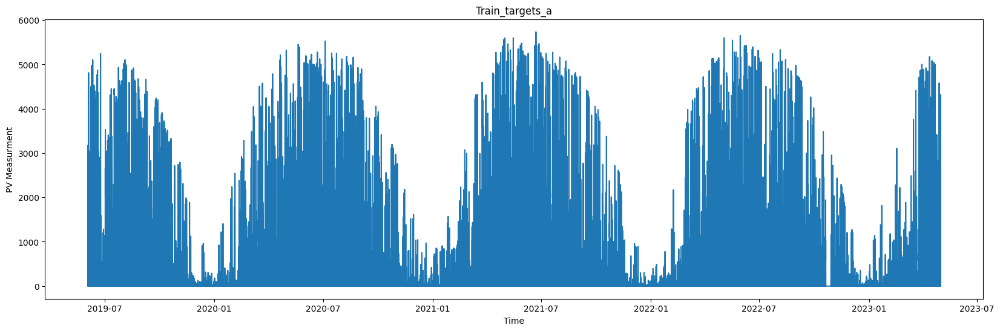

In [470]:
#plotting train_targets_a
plt.figure(figsize=(20,6))
plt.plot(train_targets_a["time"], train_targets_a["pv_measurement"])
plt.xlabel("Time")
plt.ylabel("PV Measurment")
plt.title("Train_targets_a")
plt.show()

We can se a general trend of lower measuremtns around January. Probably some gaps that needs to be deleted

Its hard to see about the 0's from this plot, so let's look at a 1 month, 1 week and 2 day interval

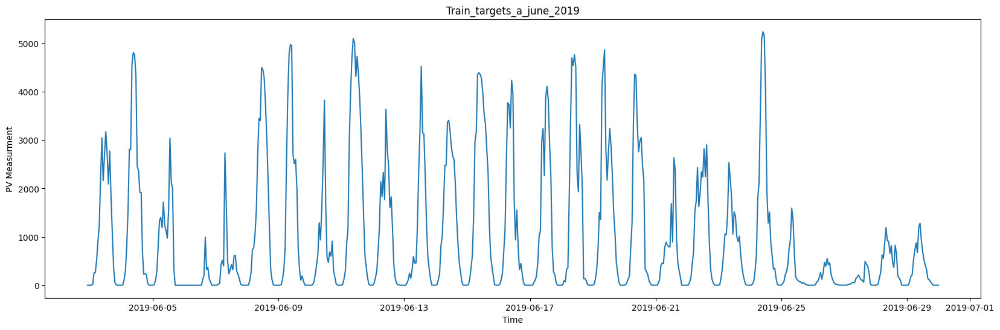

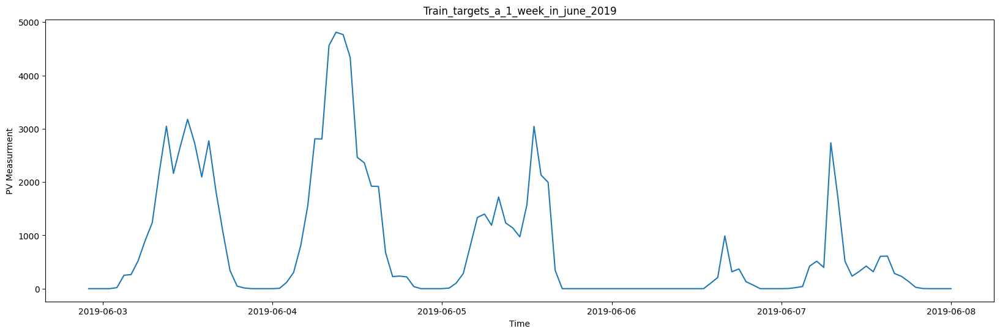

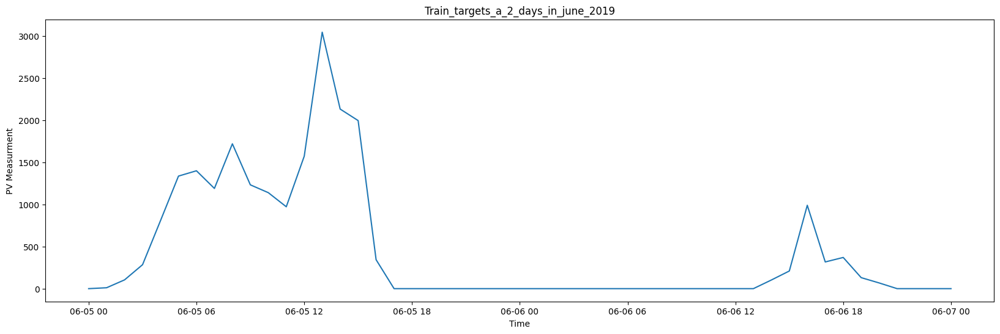

In [471]:
#plotting A targets for a month, week, and two days

for day in ["30", "08", "07"]:
    if day!="07":
        start_date = pd.Timestamp('2019-06-01')
        end_date = pd.Timestamp('2019-06-'+day)
        filtered_train_targets_a = train_targets_a[(train_targets_a['time'] >= start_date) & (train_targets_a['time'] <= end_date)]
        plt.figure(figsize=(20, 6))
        plt.plot(filtered_train_targets_a["time"], filtered_train_targets_a["pv_measurement"])
        plt.xlabel("Time")
        plt.ylabel("PV Measurment")
        if day=="30":
            plt.title("Train_targets_a_june_2019")
            plt.show()
        else:
            plt.title("Train_targets_a_1_week_in_june_2019")
            plt.show()
    else:
        start_date = pd.Timestamp('2019-06-05')
        end_date = pd.Timestamp('2019-06-'+day)
        filtered_train_targets_a = train_targets_a[(train_targets_a['time'] >= start_date) & (train_targets_a['time'] <= end_date)]
        plt.figure(figsize=(20, 6))
        plt.plot(filtered_train_targets_a["time"], filtered_train_targets_a["pv_measurement"])
        plt.xlabel("Time")
        plt.ylabel("PV Measurment")
        plt.title("Train_targets_a_2_days_in_june_2019")
        plt.show()

It's a bit weird that the 6'th has so many 0 measurements constantly.

F.example looking at 12 o'clock, its a bit weird that it is 0 when comparing to the day before.

MIGHT HAVE TO DO SOME CLEANING BASED ON THIS MATHIAS?

At least we should look at the features for days like this. It could make sense with zero production at all if it was reaaaaly clouded or no sun and stuff like that. 

I want to create a plot were I remove all 0's for fun to see what it looks like

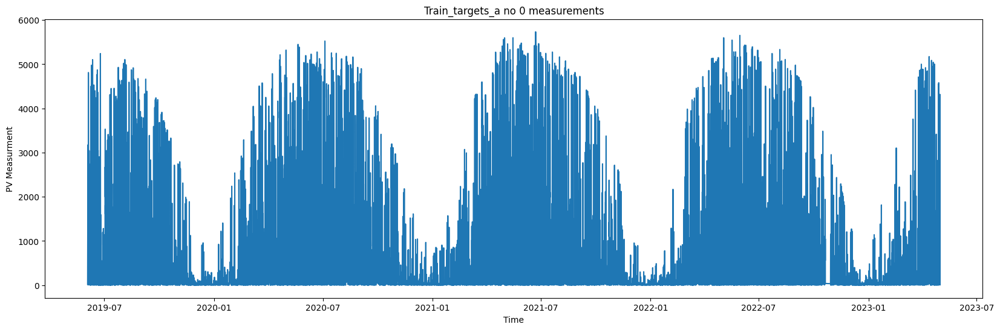

In [472]:
#plotting targets for location A where there are no 0 measurements:
train_targets_a_no_0_pvs = train_targets_a[train_targets_a["pv_measurement"] != 0]
plt.figure(figsize=(20,6))
plt.plot(train_targets_a_no_0_pvs["time"], train_targets_a_no_0_pvs["pv_measurement"])
plt.xlabel("Time")
plt.ylabel("PV Measurment")
plt.title("Train_targets_a no 0 measurements")
plt.show()

Okay this one was not that interesting

## Train_targets for all locations

Let's show the head for B and C as well

#### train_targets_b

In [473]:
train_targets_b.head()

,time,pv_measurement
0,2018-12-31 23:00:00,0.0
1,2019-01-01 00:00:00,0.0
2,2019-01-01 01:00:00,0.0
3,2019-01-01 02:00:00,0.0
4,2019-01-01 03:00:00,0.0


#### train_targets_c

In [474]:
train_targets_c.head()

,time,pv_measurement
0,2018-12-31 23:00:00,NaN
1,2019-01-01 00:00:00,NaN
2,2019-01-01 01:00:00,NaN
3,2019-01-01 02:00:00,NaN
4,2019-01-01 03:00:00,NaN


Interesting that C has some NaN obersvations, these for sure have to be removed

Let's also count 0 and negative measurements for B and C just so we know our data a bit better:
We also check for NaN observations

In [475]:
#B

from pandas import isna


train_targets_b_0_pvs = train_targets_b[train_targets_b["pv_measurement"] == 0]
train_targets_b_negative_pvs = train_targets_b[train_targets_b["pv_measurement"] < 0]
train_target_b_Nan_pvs = train_targets_b[isna(train_targets_b["pv_measurement"])]
count_targets_b =  len(train_targets_b)
count_targett_pvs_0_b = len(train_targets_b_0_pvs)
count_target_negative_b = len(train_targets_b_negative_pvs)
count_target_nan_b = len(train_target_b_Nan_pvs)
print("Number of rows in  train_targets_b: ", count_targets_b)
print("Number of rows in train_targets_b with 0 measurments: ", count_targett_pvs_0_b)
print("Number of rows in train_targets_b with negative measurments: ", count_target_negative_b)
print("Number of rows in train_targets_b with NaN measurments: ", count_target_nan_b)

Number of rows in  train_targets_b:  32848
Number of rows in train_targets_b with 0 measurments:  17312
Number of rows in train_targets_b with negative measurments:  0
Number of rows in train_targets_b with NaN measurments:  4


In [476]:
#C

train_targets_c_0_pvs = train_targets_c[train_targets_c["pv_measurement"] == 0]
train_targets_c_negative_pvs = train_targets_c[train_targets_c["pv_measurement"] < 0]
train_target_c_Nan_pvs = train_targets_c[isna(train_targets_c["pv_measurement"])]
count_targets_c =  len(train_targets_c)
count_targett_pvs_0_c = len(train_targets_c_0_pvs)
count_target_negative_c = len(train_targets_c_negative_pvs)
count_target_nan_c = len(train_target_c_Nan_pvs)
print("Number of rows in  train_targets_c: ", count_targets_c)
print("Number of rows in train_targets_c with 0 measurments: ", count_targett_pvs_0_c)
print("Number of rows in train_targets_c with negative measurments: ", count_target_negative_c)
print("Number of rows in train_targets_c with NaN measurments: ", count_target_nan_c)

Number of rows in  train_targets_c:  32155
Number of rows in train_targets_c with 0 measurments:  15952
Number of rows in train_targets_c with negative measurments:  0
Number of rows in train_targets_c with NaN measurments:  6060


Again, a lot of 0 measurements, but no negative, thats good. 

A lot of NaN measurements in C however, so all of those needs to be removed probably.

I am gonna check for NaN in A now as well, now that we did find this out:

In [477]:
# NaN in A
train_target_a_Nan_pvs = train_targets_a[isna(train_targets_a["pv_measurement"])]
count_target_nan_a = len(train_target_a_Nan_pvs)
print("Number of rows in train_targets_a with NaN measurments: ", count_target_nan_a)


Number of rows in train_targets_a with NaN measurments:  0


Okay so no NaN's in A

#### All locations together

I think it's interesting to see a bit more of the training targets combined. Plotting the train_targets for the 3 locations in the same plot:


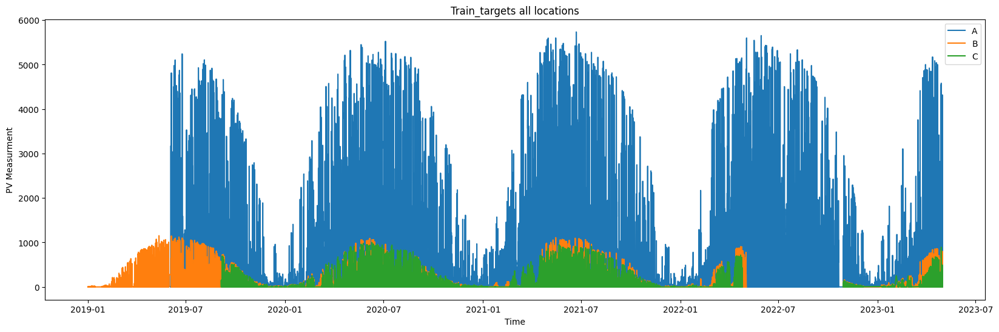

In [478]:
#plotting all train targets up against eachother
plt.figure(figsize=(20,6))
plt.plot(train_targets_a["time"], train_targets_a["pv_measurement"], label="A")
plt.plot(train_targets_b["time"], train_targets_b["pv_measurement"], label="B")
plt.plot(train_targets_c["time"], train_targets_c["pv_measurement"], label="C")
plt.legend()
plt.xlabel("Time")
plt.ylabel("PV Measurment")
plt.title("Train_targets all locations")
plt.show()



Looks like location B and C are more similar in their production values than A.
Actually they look extremely similar in their trends it looks like .

We can also see that the trend of lower values around January seems to hold for all locations.

We can also see that their are some pretty big gaps in the dates, but that corresponds to observed and estimated sets.

For A we can see a chunk of 0 measurements some time before January 2023, this gap SOULD probably be inspected more. 

## Time comparisons

Now moving on from only the train_targets, I want to look at the time frames that the different dasets contains.

NOT FINISHED!!!!

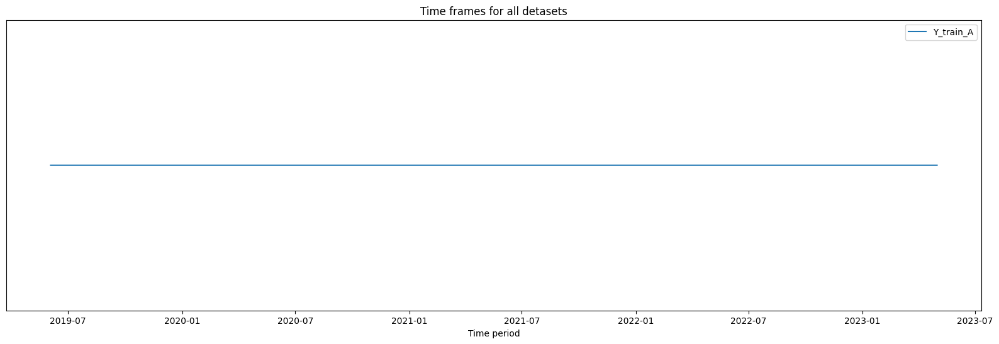

In [479]:
plt.figure(figsize=(20,6))
y_values_1 = [0]*len(train_targets_a)
plt.plot(train_targets_a["time"], y_values_1, label="Y_train_A")
plt.xlabel("Time period")
plt.yticks([])
plt.title("Time frames for all detasets")
plt.legend()
plt.show()

## Looking at the features

### Describing training sets:

#### A

In [480]:
#observed
X_train_observed_a.describe().transpose()

,count,mean,min,25%,50%,75%,max,std
date_forecast,118669,2021-02-09 23:30:00,2019-06-02 22:00:00,2020-04-06 22:45:00,2021-02-09 23:30:00,2021-12-16 00:15:00,2022-10-21 01:00:00,NaN
absolute_humidity_2m:gm3,118669.0,6.652576,0.7,4.4,6.3,8.6,17.5,2.796349
air_density_2m:kgm3,118669.0,1.249064,1.145,1.224,1.247,1.272,1.427,0.036319
ceiling_height_agl:m,96422.0,2907.949219,27.799999,1102.900024,1882.400024,3969.75,12328.5,2570.413086
clear_sky_energy_1h:J,118669.0,599401.75,0.0,0.0,35747.699219,1037818.8125,3005720.25,879542.3125
clear_sky_rad:W,118669.0,166.500381,0.0,0.0,8.6,288.799988,836.400024,244.945358
cloud_base_agl:m,110603.0,1737.142212,27.9,590.700012,1162.599976,2079.600098,11688.700195,1815.584106
dew_or_rime:idx,118669.0,0.022398,-1.0,0.0,0.0,0.0,1.0,0.190367
dew_point_2m:K,118669.0,276.823395,250.899994,272.100006,277.200012,282.0,293.799988,6.701763
diffuse_rad:W,118669.0,44.918282,0.0,0.0,4.1,76.0,345.700012,64.786697


Observations:
 - snow_density:kgm3 is equal for all observations --> should probably be deleted from the model
 - ceiling height does not match the count as the others, so probably a lot of Nan values
 - cloud base hase fewer

In [481]:
#estimated
X_train_estimated_a.describe().transpose()

,count,mean,min,25%,50%,75%,max,std
date_calc,17576,2023-01-27 19:07:13.160673,2022-10-27 07:00:18,2022-12-12 08:00:05,2023-01-28 08:00:04,2023-03-15 08:00:04,2023-04-29 07:00:05,NaN
date_forecast,17576,2023-01-28 23:11:50.127446,2022-10-28 22:00:00,2022-12-13 16:26:15,2023-01-29 10:52:30,2023-03-16 05:18:45,2023-04-30 23:45:00,NaN
absolute_humidity_2m:gm3,17576.0,4.092438,1.0,3.0,3.9,5.1,8.8,1.51115
air_density_2m:kgm3,17576.0,1.281746,1.212,1.262,1.279,1.301,1.374,0.03005
ceiling_height_agl:m,13657.0,3257.459473,27.9,1185.5,2750.0,4775.5,12307.700195,2501.79834
clear_sky_energy_1h:J,17576.0,237126.34375,0.0,0.0,0.0,137487.355469,2555980.0,517343.46875
clear_sky_rad:W,17576.0,65.868149,0.0,0.0,0.0,37.400002,711.599976,144.162888
cloud_base_agl:m,15482.0,1575.233032,27.799999,497.524994,935.75,1919.599976,10813.700195,1718.795166
dew_or_rime:idx,17576.0,0.00899,-1.0,0.0,0.0,0.0,1.0,0.22154
dew_point_2m:K,17576.0,270.222351,254.699997,266.799988,270.399994,273.899994,282.100006,5.215952


Observations: 
 - snow_density
 - ceiling height
 - cloud base has less datapoints
 - snow_depth : 25%, 50%, 75% = 0, max = 4.9 --> is there outliers here?

#### B

In [506]:
#observed
X_train_observed_b.describe().transpose()

,count,mean,min,25%,50%,75%,max,std
date_forecast,116929,2020-09-01 00:00:00,2019-01-01 00:00:00,2019-11-01 12:00:00,2020-09-01 00:00:00,2021-07-02 12:00:00,2022-05-03 00:00:00,NaN
absolute_humidity_2m:gm3,116929.0,6.125604,0.7,4.1,5.5,8.0,17.5,2.727944
air_density_2m:kgm3,116929.0,1.254262,1.151,1.23,1.254,1.277,1.426,0.035289
ceiling_height_agl:m,98157.0,2651.450439,27.799999,1037.900024,1732.300049,3412.199951,12328.799805,2404.853516
clear_sky_energy_1h:J,116929.0,542151.4375,0.0,0.0,12710.200195,869361.1875,3005700.5,840052.25
clear_sky_rad:W,116929.0,150.59758,0.0,0.0,0.0,242.0,836.400024,233.948273
cloud_base_agl:m,109456.0,1731.706665,27.9,648.799988,1219.800049,2074.100098,11688.900391,1726.011108
dew_or_rime:idx,116929.0,0.008484,-1.0,0.0,0.0,0.0,1.0,0.117327
dew_point_2m:K,116929.0,275.524536,250.899994,271.100006,275.299988,280.799988,293.799988,6.773766
diffuse_rad:W,116929.0,40.894447,0.0,0.0,0.0,69.0,345.700012,61.530506


Observations:
 - elevation constant
 - snow_desnity
 - ceiling_height

In [507]:
#estimated
X_train_estimated_b.describe().transpose()

,count,mean,min,25%,50%,75%,max,std
date_calc,17576,2023-01-27 19:07:13.160673,2022-10-27 07:00:18,2022-12-12 08:00:05,2023-01-28 08:00:04,2023-03-15 08:00:04,2023-04-29 07:00:05,NaN
date_forecast,17576,2023-01-28 23:11:50.127446,2022-10-28 22:00:00,2022-12-13 16:26:15,2023-01-29 10:52:30,2023-03-16 05:18:45,2023-04-30 23:45:00,NaN
absolute_humidity_2m:gm3,17576.0,4.09315,1.0,3.0,3.9,5.1,8.8,1.513466
air_density_2m:kgm3,17576.0,1.280473,1.21,1.261,1.278,1.299,1.37,0.029161
ceiling_height_agl:m,13887.0,3247.021729,27.9,1180.5,2736.800049,4755.0,12316.700195,2496.41333
clear_sky_energy_1h:J,17576.0,237121.171875,0.0,0.0,0.0,137469.15625,2555956.25,517336.875
clear_sky_rad:W,17576.0,65.866737,0.0,0.0,0.0,37.400002,711.599976,144.161041
cloud_base_agl:m,15613.0,1585.469604,27.799999,499.5,940.099976,1927.599976,10814.5,1732.807373
dew_or_rime:idx,17576.0,0.007112,-1.0,0.0,0.0,0.0,1.0,0.152385
dew_point_2m:K,17576.0,270.210114,254.699997,266.799988,270.399994,273.899994,282.100006,5.237202


Observations:

#### C

In [508]:
#observed
X_train_observed_c.describe().transpose()

,count,mean,min,25%,50%,75%,max,std
date_forecast,116825,2020-08-31 11:00:00,2019-01-01 00:00:00,2019-11-01 05:30:00,2020-08-31 11:00:00,2021-07-01 16:30:00,2022-05-01 22:00:00,NaN
absolute_humidity_2m:gm3,116825.0,6.013866,0.5,4.0,5.4,7.9,18.9,2.78984
air_density_2m:kgm3,116825.0,1.253214,1.139,1.228,1.253,1.277,1.441,0.038392
ceiling_height_agl:m,96902.0,2605.747559,27.799999,981.400024,1643.0,3406.175049,12431.299805,2415.11792
clear_sky_energy_1h:J,116825.0,542358.3125,0.0,0.0,12679.799805,869863.1875,3007721.5,840484.3125
clear_sky_rad:W,116825.0,150.655075,0.0,0.0,0.0,242.0,837.0,234.069214
cloud_base_agl:m,108313.0,1710.178467,27.9,618.5,1178.400024,2056.399902,11665.700195,1751.569336
dew_or_rime:idx,116825.0,-0.013867,-1.0,0.0,0.0,0.0,1.0,0.369077
dew_point_2m:K,116825.0,275.1474,247.300003,270.600006,274.899994,280.600006,295.100006,7.103381
diffuse_rad:W,116825.0,40.920612,0.0,0.0,0.0,68.900002,344.5,61.696342


Observations:

In [509]:
#estimated
X_train_estimated_c.describe().transpose()

,count,mean,min,25%,50%,75%,max,std
date_calc,17576,2023-01-27 19:07:13.160673,2022-10-27 07:00:18,2022-12-12 08:00:05,2023-01-28 08:00:04,2023-03-15 08:00:04,2023-04-29 07:00:05,NaN
date_forecast,17576,2023-01-28 23:11:50.127446,2022-10-28 22:00:00,2022-12-13 16:26:15,2023-01-29 10:52:30,2023-03-16 05:18:45,2023-04-30 23:45:00,NaN
absolute_humidity_2m:gm3,17576.0,3.92735,0.8,2.8,3.8,4.9,8.9,1.573211
air_density_2m:kgm3,17576.0,1.281578,1.207,1.261,1.278,1.301,1.384,0.032246
ceiling_height_agl:m,12980.0,3403.212646,27.6,1266.375,2871.149902,4948.549805,12115.400391,2507.600098
clear_sky_energy_1h:J,17576.0,237646.59375,0.0,0.0,0.0,138800.773438,2558351.5,518004.65625
clear_sky_rad:W,17576.0,66.013062,0.0,0.0,0.0,37.799999,712.299988,144.348022
cloud_base_agl:m,14772.0,1738.442749,27.299999,515.275024,989.049988,2067.024902,10725.599609,1914.490967
dew_or_rime:idx,17576.0,-0.093707,-1.0,0.0,0.0,0.0,1.0,0.40877
dew_point_2m:K,17576.0,269.505615,251.899994,265.899994,269.899994,273.600006,282.399994,5.731794


## Importance of time

## Outlier detection

Method: Going through all locations. For every location, for both training sets: loop trough all features and make scatter plot. 

In [501]:
# making a function that plots all the plots for a location and a set
def makeSuperManyPlots(df1, df2, df3, location):
    for feature in df1.columns:
        if feature != "date_forecast" and feature != "date_calc":
            plt.figure(figsize=(20,6))
            plt.scatter(df1["date_forecast"], df1[feature], s=1)
            plt.scatter(df2["date_forecast"], df2[feature], s=1, color="red" )
            plt.scatter(df3["date_forecast"], df3[feature], s=1, color="green")
            plt.title("Scatterplot of " + feature + " for location " + location)
            plt.xlabel("Time")
            plt.ylabel("Feature value")
            plt.xticks(rotation=45)
            plt.show()
    

### Location A

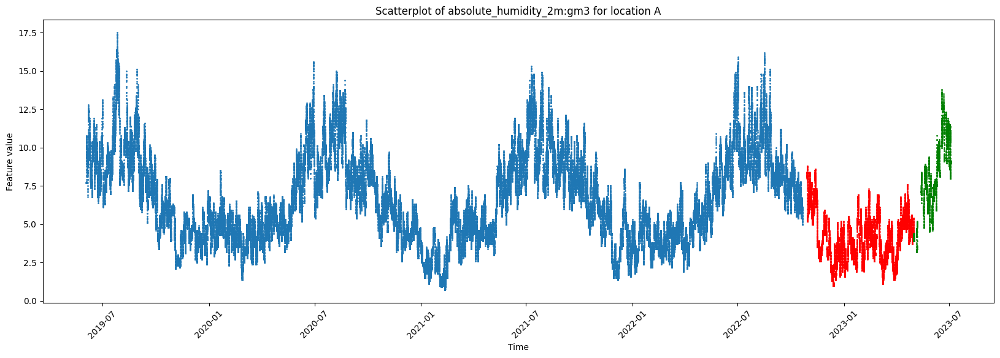

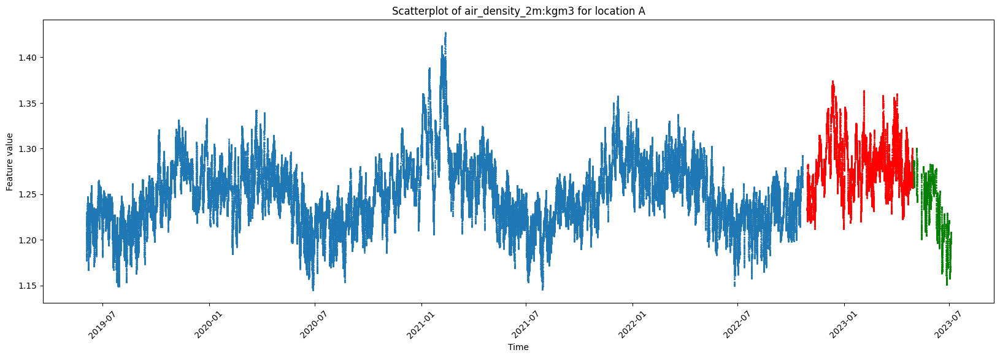

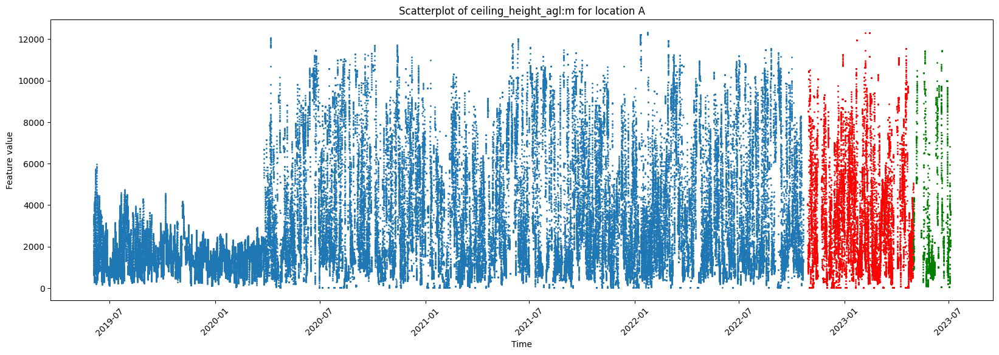

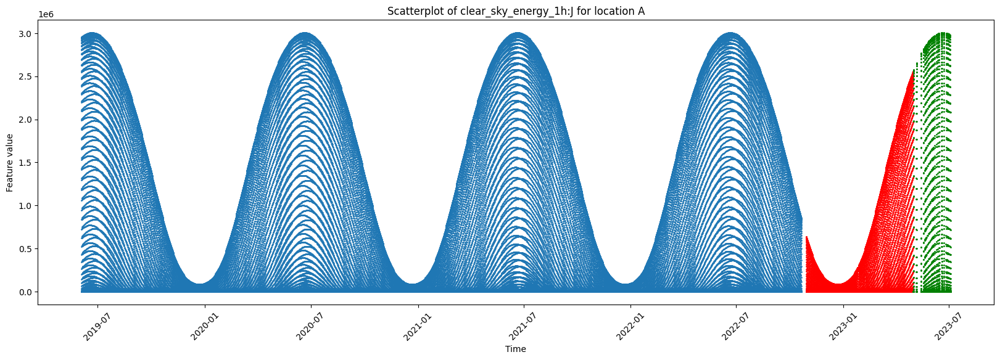

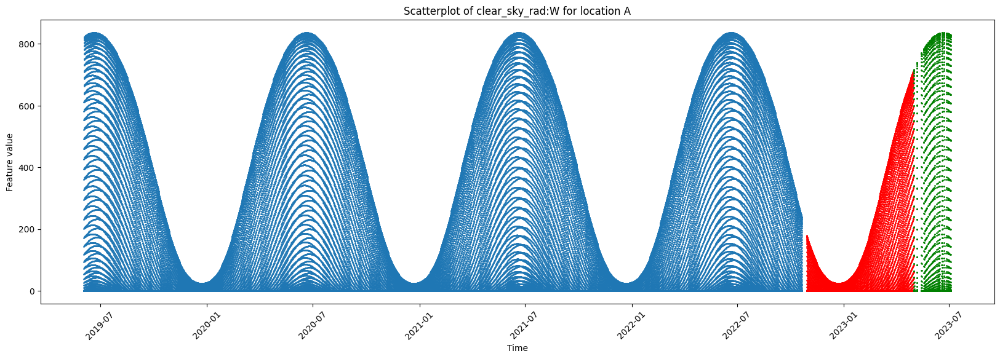

...

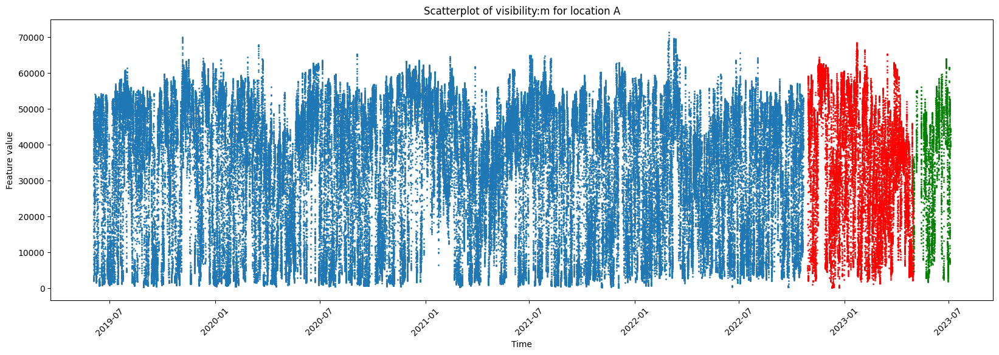

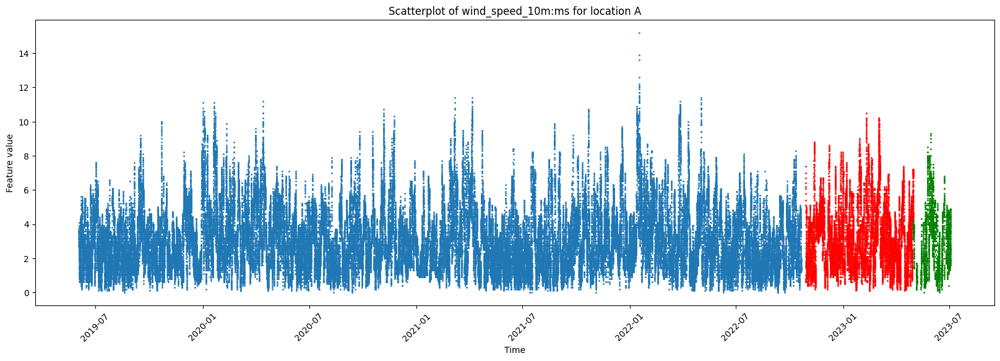

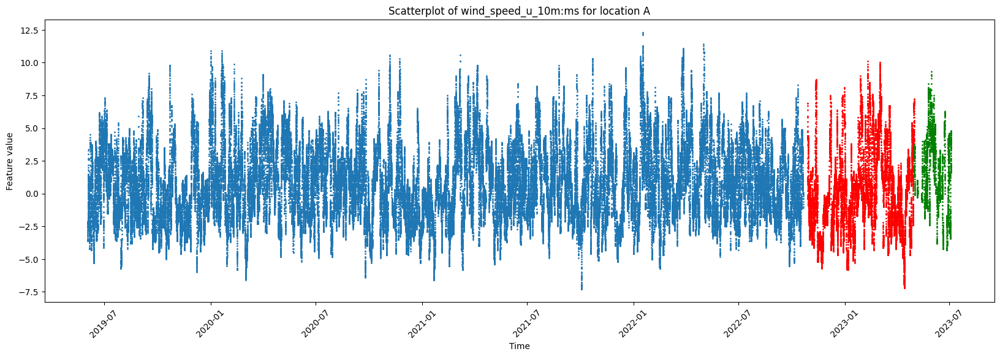

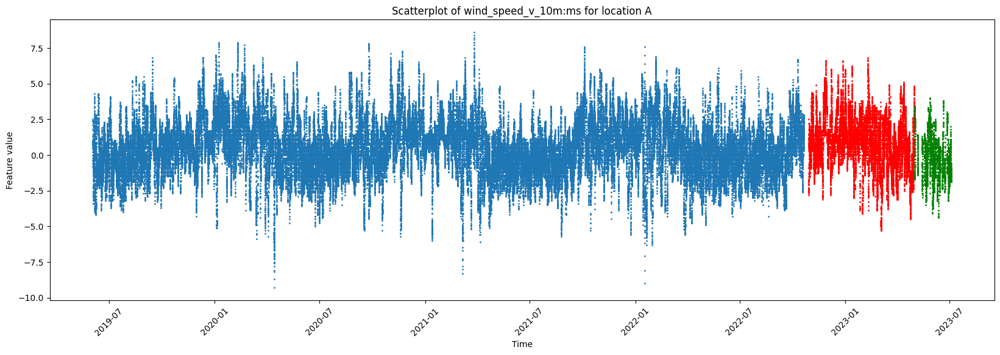

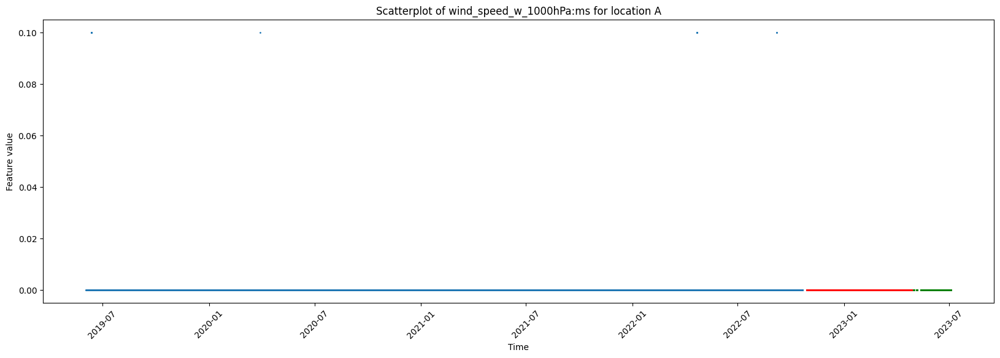

In [502]:
makeSuperManyPlots(X_train_observed_a,X_train_estimated_a, X_test_estimated_a,"A")

### Location B

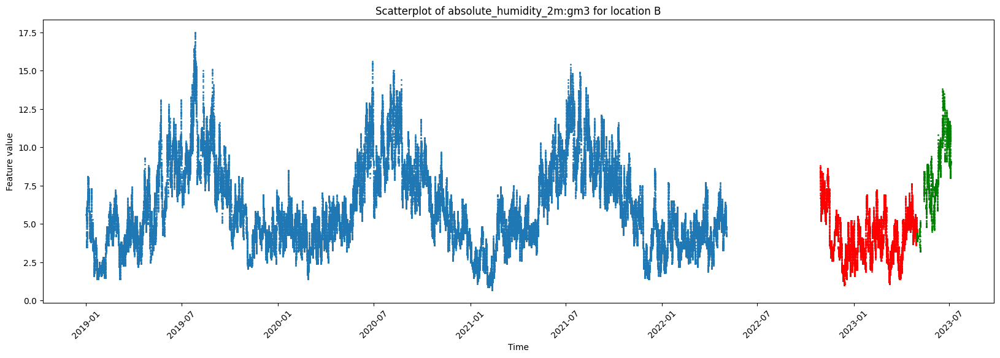

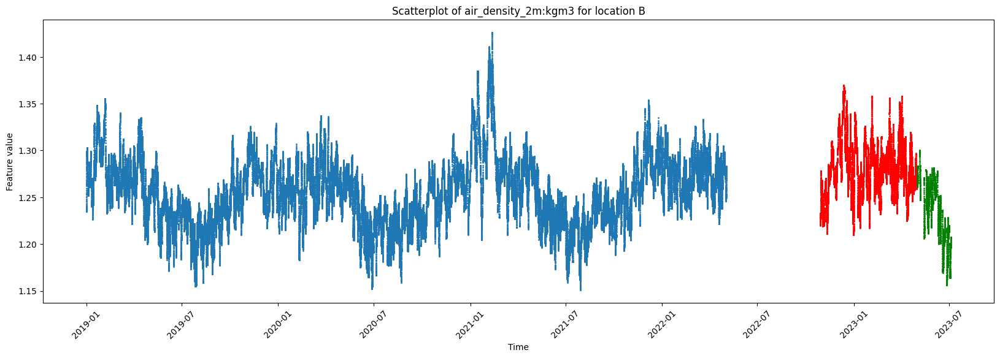

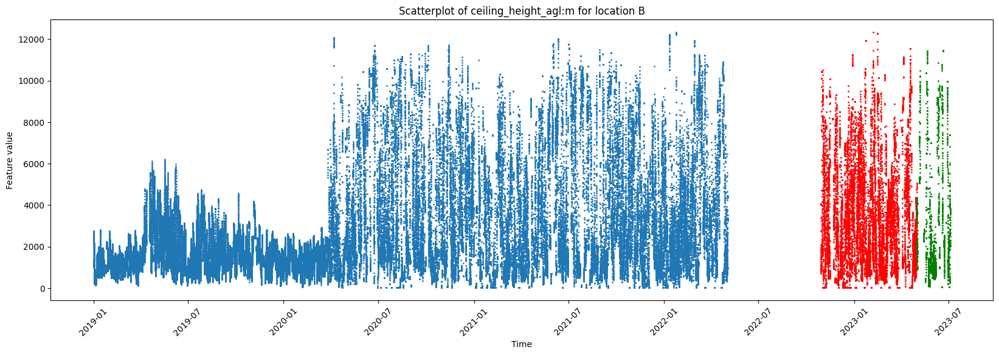

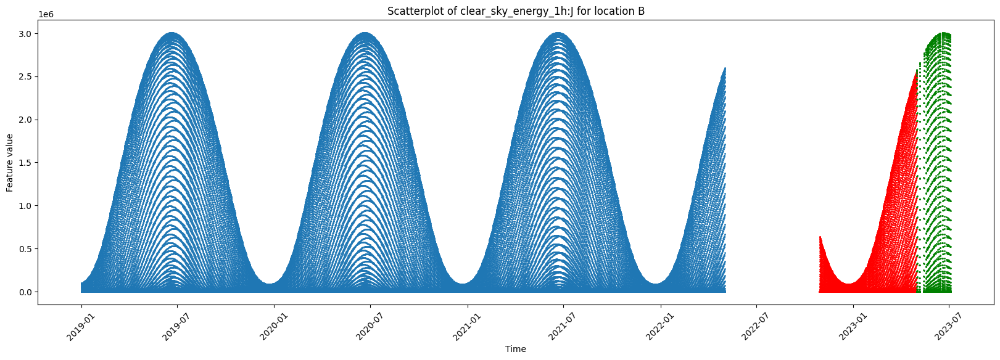

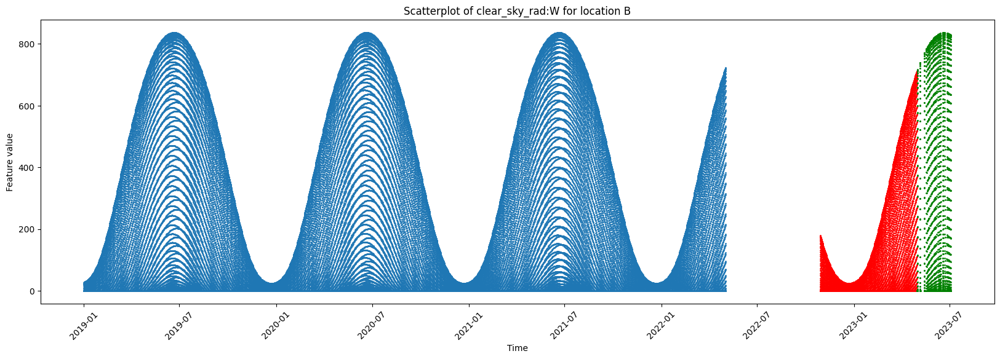

...

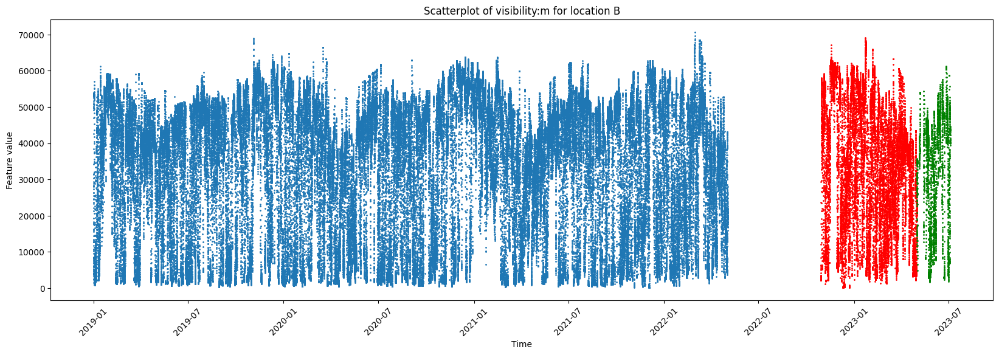

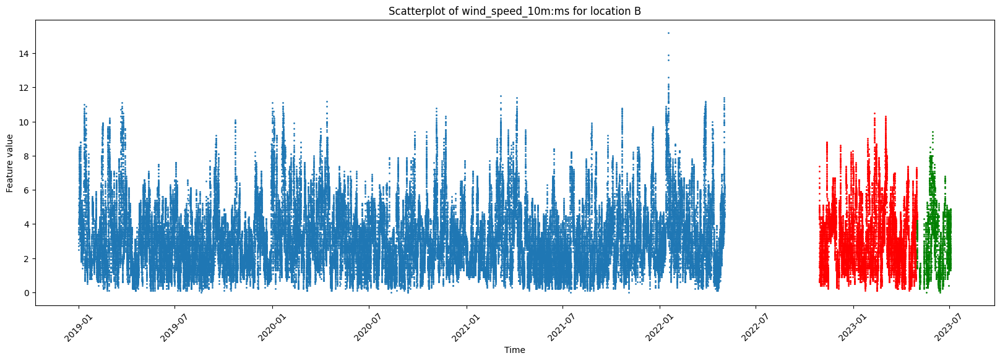

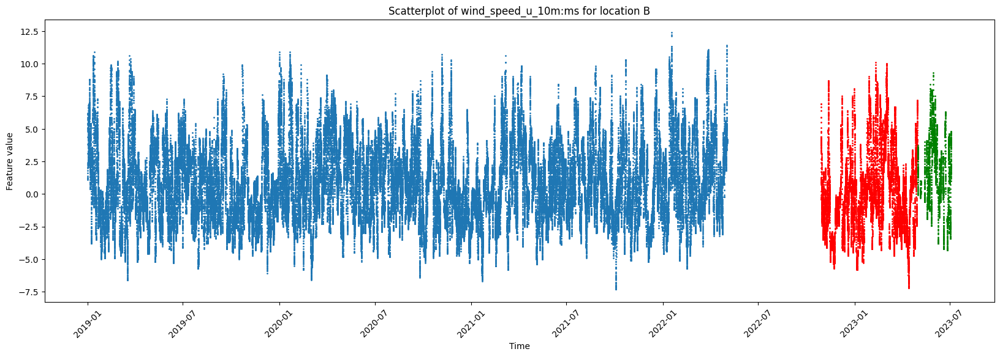

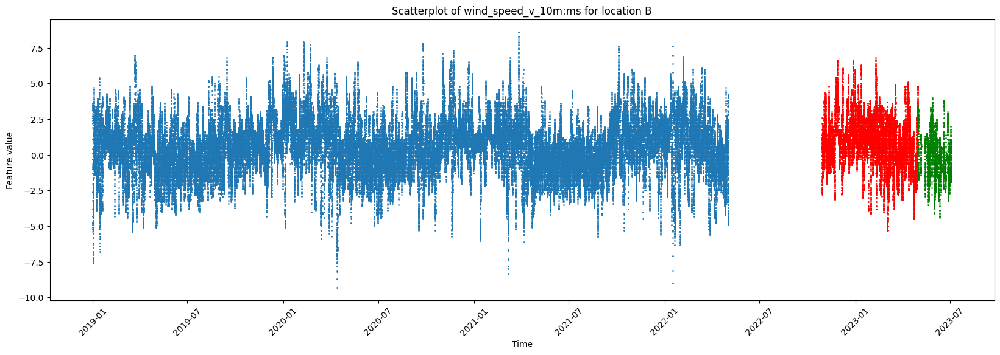

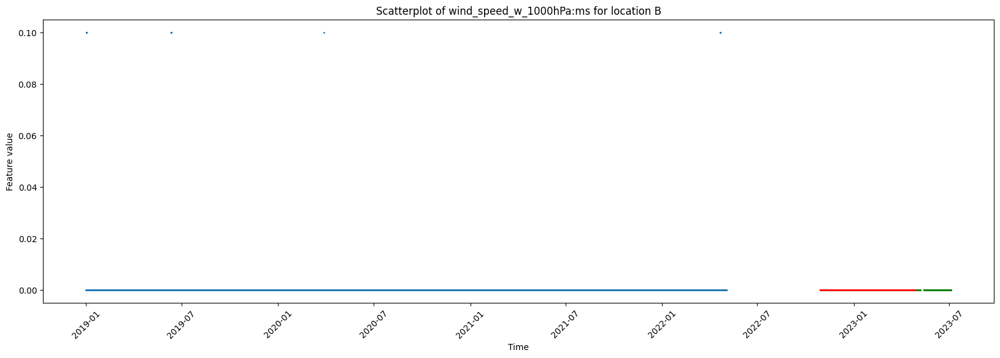

In [504]:
makeSuperManyPlots(X_train_observed_b,X_train_estimated_b, X_test_estimated_b,"B")

### Location C

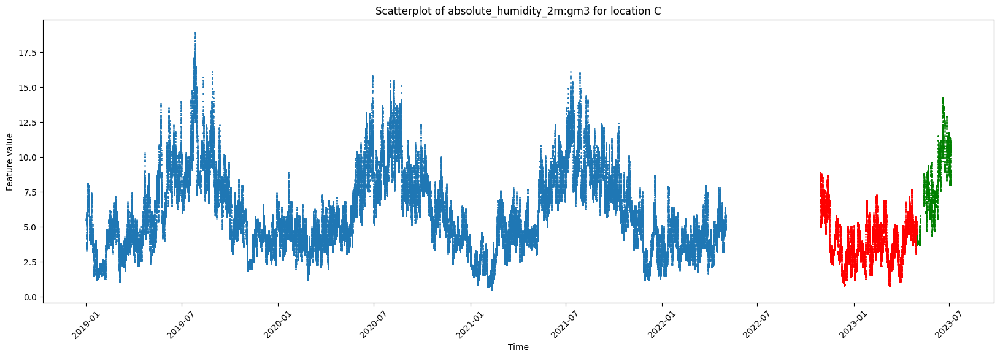

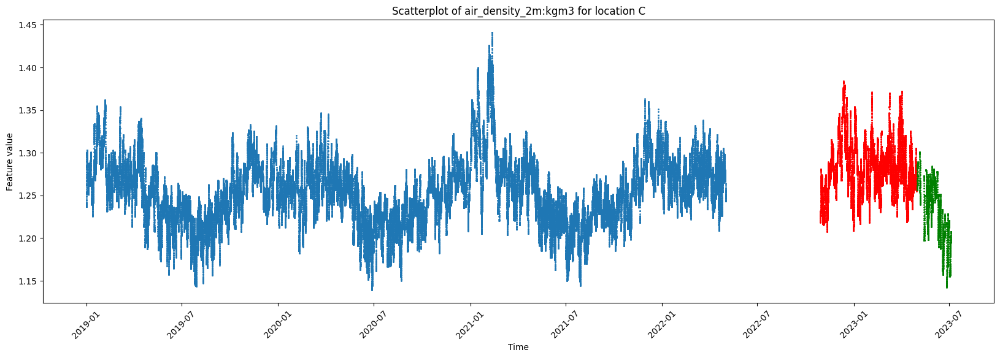

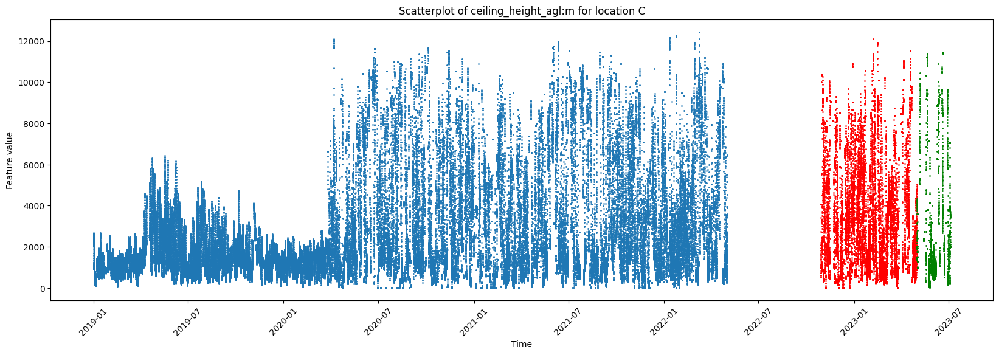

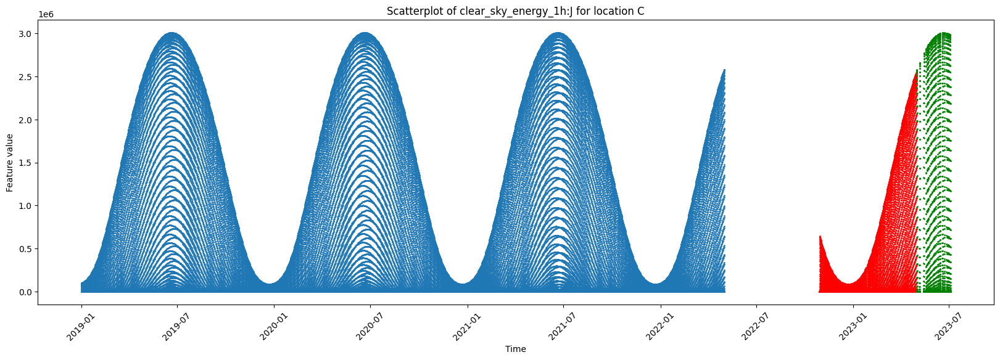

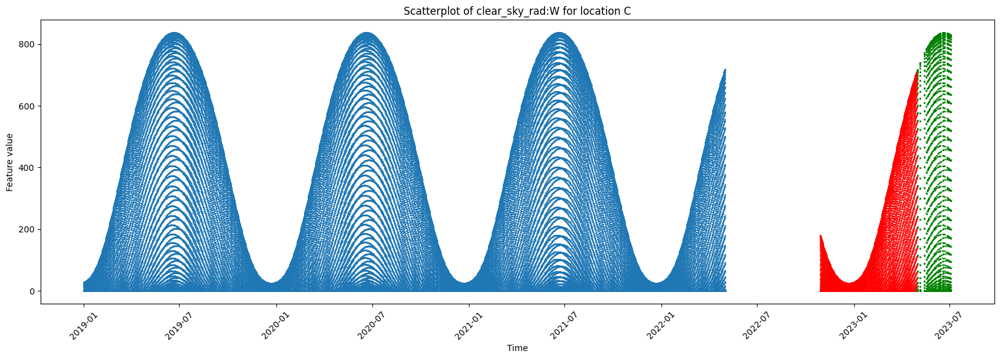

...

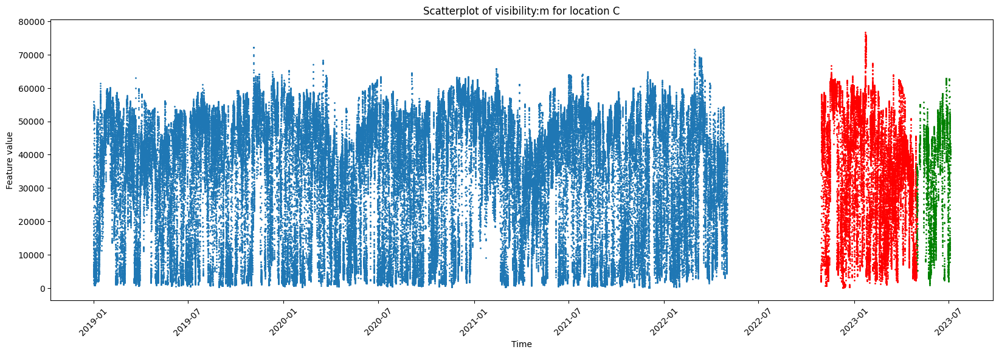

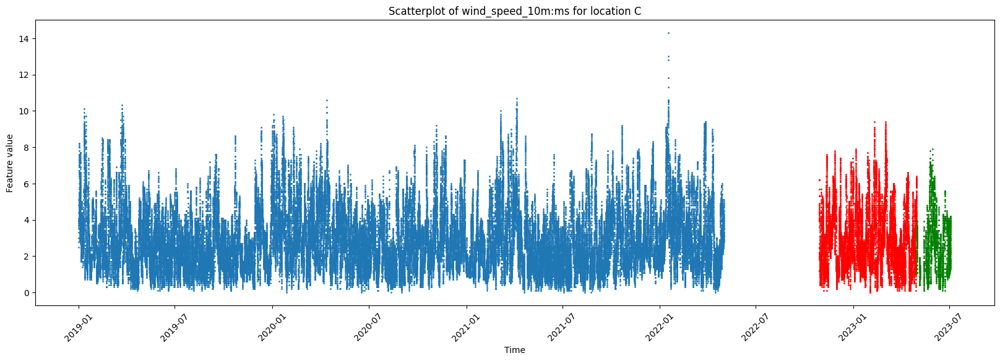

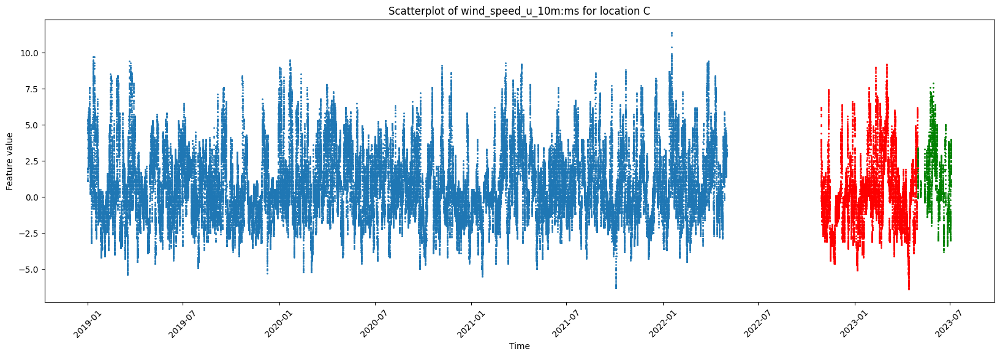

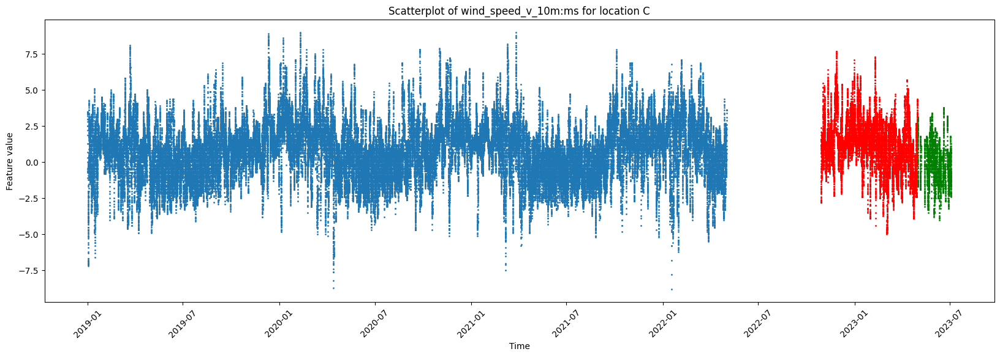

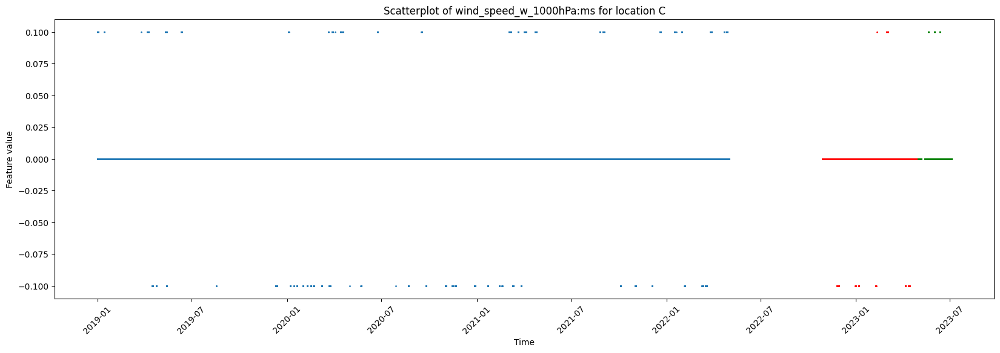

In [505]:
makeSuperManyPlots(X_train_observed_c,X_train_estimated_c, X_test_estimated_c,"C")

### Checking overlap

In [532]:
#finding the first element of the estimated training set, and the last element of the estimated test set to se iff there is overlap
last_element_of_A_estimated_train = X_train_estimated_a.iloc[-1:]

last_element_of_A_estimated_train.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
17575,2023-04-29 07:00:05,2023-04-30 23:45:00,4.5,1.281,2198.899902,0.0,0.0,510.700012,0.0,272.299988,...,7.782,-11.69,0.0,274.299988,99.300003,13809.099609,3.8,2.7,2.7,-0.0


In [533]:
first_element_of_A_estimated_test = X_test_estimated_a.iloc[[0]]
first_element_of_A_estimated_test.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2023-04-30 07:00:04,2023-05-01,4.4,1.286,912.700012,0.0,0.0,1041.199951,0.0,271.700012,...,10.52,-11.185,0.0,273.799988,80.699997,30210.699219,4.0,2.2,3.4,-0.0


We can see that there is no overlap.

We can check the same for observed and estimated training values

In [537]:
#Doing the same for observed and estimated trained data as well, althoug I don't think there is overlap
last_element_of_A_observed_training = X_train_observed_a.iloc[-1:]
last_element_of_A_observed_training.head()



,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,diffuse_rad:W,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
118668,2022-10-21 01:00:00,5.0,1.292,NaN,0.0,0.0,NaN,0.0,273.600006,0.0,...,34.306999,-33.417,0.0,276.399994,0.5,36795.0,1.5,-1.1,1.0,-0.0


In [538]:
first_element_of_A_estimated_training = X_test_estimated_a.iloc[[0]]
first_element_of_A_estimated_training.head()

,date_calc,date_forecast,absolute_humidity_2m:gm3,air_density_2m:kgm3,ceiling_height_agl:m,clear_sky_energy_1h:J,clear_sky_rad:W,cloud_base_agl:m,dew_or_rime:idx,dew_point_2m:K,...,sun_azimuth:d,sun_elevation:d,super_cooled_liquid_water:kgm2,t_1000hPa:K,total_cloud_cover:p,visibility:m,wind_speed_10m:ms,wind_speed_u_10m:ms,wind_speed_v_10m:ms,wind_speed_w_1000hPa:ms
0,2023-04-30 07:00:04,2023-05-01,4.4,1.286,912.700012,0.0,0.0,1041.199951,0.0,271.700012,...,10.52,-11.185,0.0,273.799988,80.699997,30210.699219,4.0,2.2,3.4,-0.0


No overlap